# Goal 1: "Play" the Video on the Colab Notebook. This Video Will Be Our Ground Truth

In [1]:
import os
from moviepy.editor import ImageSequenceClip

folder_path = 'DAVIS_image_files_full_resolution'
image_files = os.listdir(folder_path)
image_files.sort()

# Create a list to store image frames
cleanFrames = []
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    cleanFrames.append(image_path)

In [3]:
import moviepy.editor as mp

# Create a video clip from the frames
video = mp.ImageSequenceClip(cleanFrames, fps=30)

# Specify the path to the video file
video_path = 'C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/ground_video.mp4'

# Write the filtered video to disk
video.write_videofile(video_path, codec='libx264', audio=False)

# Load the video file
video = mp.VideoFileClip(video_path)

# Set the desired width and height for the resized video
width = 640
height = 480

# Resize the video while maintaining the aspect ratio
video_resized = video.resize(width=width)

# Display the resized video in the notebook
video_resized.ipython_display()

t:   6%|▌         | 2/35 [01:56<32:05, 58.36s/it, now=None]

Moviepy - Building video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/ground_video.mp4.
Moviepy - Writing video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/ground_video.mp4



t:   6%|▌         | 2/35 [02:02<33:43, 61.31s/it, now=None]

Moviepy - Done !
Moviepy - video ready C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/ground_video.mp4


t:   6%|▌         | 2/35 [02:04<34:09, 62.10s/it, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:   6%|▌         | 2/35 [02:08<35:27, 64.46s/it, now=None]

Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Goal 2: Add Salt and Pepper Noise to the Video
# Goal 4: "Play" the Noisy Video in the Notebook

In [8]:
import os
import cv2
import numpy as np
from moviepy.editor import ImageSequenceClip

In [9]:
def add_salt_pepper_noise(image, noise_level):
    noisy_image = np.copy(image)
    height, width, _ = noisy_image.shape
    num_pixels = int(noise_level * height * width)

    # Generate random coordinates
    random_coordinates = np.random.randint(0, high=(width, height), size=(num_pixels, 2))

    # Generate random values for salt (white pixels) and pepper (black pixels)
    salt_value = [255, 255, 255]
    pepper_value = [0, 0, 0]

    # Add salt and pepper noise to the random coordinates
    for x, y in random_coordinates:
        noisy_image[y, x] = salt_value if np.random.rand() < 0.5 else pepper_value

    return noisy_image

In [10]:
# Specify the folder path containing the images
folder_path = 'DAVIS_image_files_full_resolution'
image_files = os.listdir(folder_path)
image_files.sort()

In [11]:
# Create a list to store image frames
noisyFrames = []
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Read the image
    image = cv2.imread(image_path)

    # Convert color channel ordering from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Add salt and pepper noise to the image
    noisy_image = add_salt_pepper_noise(image, noise_level=0.10)  # Adjust the noise level as desired

    # Append the noisy image to the frames list
    noisyFrames.append(noisy_image)

In [13]:
# Create a video clip from the frames
video = ImageSequenceClip(noisyFrames, fps=30)

# Define the output video path
noisy_video_path = 'C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/noisy_video.mp4'

# Write the filtered video to disk
video.write_videofile(noisy_video_path, codec='libx264', audio=False)

# Load the noisy video file
video_noisy = mp.VideoFileClip(noisy_video_path)

# Set the desired width and height for the resized video
width = 640
height = 480

# Resize the video while maintaining the aspect ratio
video_resized = video_noisy.resize(width=width)

# Display the resized video in the notebook
video_resized.ipython_display()

                                                              
                                                              
t:   6%|▌         | 2/35 [08:21<2:17:51, 250.64s/it, now=None]

Moviepy - Building video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/noisy_video.mp4.
Moviepy - Writing video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/noisy_video.mp4

















                                                              
                                                              
t:   6%|▌         | 2/35 [08:31<2:20:36, 255.64s/it, now=None]

Moviepy - Done !
Moviepy - video ready C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/noisy_video.mp4


                                                              
                                                              
t:   6%|▌         | 2/35 [08:33<2:21:09, 256.65s/it, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4




































                                                              
                                                              
t:   6%|▌         | 2/35 [08:38<2:22:30, 259.10s/it, now=None]

Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Goal 3: Measure the Noise Between the Noisy and Ground Truth Images Using SSIM and PSNR

*  SSIM > 0.9: Excellent similarity. The reconstructed/filtered image closely resembles the original image.
*  0.7 < SSIM < 0.9: Good similarity. The reconstructed/filtered image has some minor differences but still maintains a high level of similarity to the original image.
*  0.5 < SSIM < 0.7: Moderate similarity. The reconstructed/filtered image has noticeable differences but still retains some level of similarity to the original image.
*  SSIM < 0.5: Poor similarity. The reconstructed/filtered image has significant differences and may not be visually similar to the original image. differences.

*   ############################################################

*   PSNR > 40 dB: Excellent quality. The reconstructed/filtered image closely resembles the original image.
*   30 dB < PSNR < 40 dB: Good quality. The reconstructed/filtered image has some minor imperfections but is still visually similar to the original image.
*    20 dB < PSNR < 30 dB: Moderate quality. The reconstructed/filtered image has noticeable distortions or noise but is still recognizable.
*    PSNR < 20 dB: Poor quality. The reconstructed/filtered image has significant distortions or noise and may differ significantly from the original image.





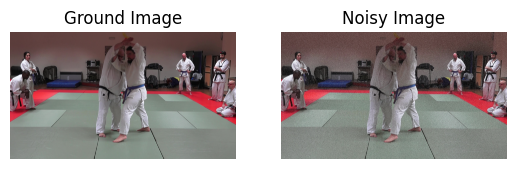

SSIM Score: 0.0799



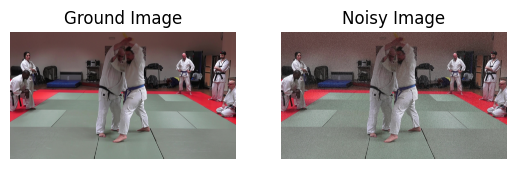

SSIM Score: 0.0795



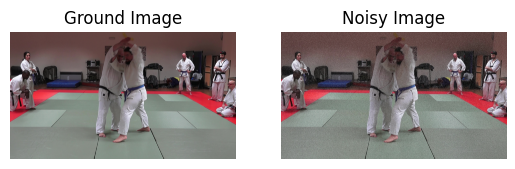

SSIM Score: 0.0796



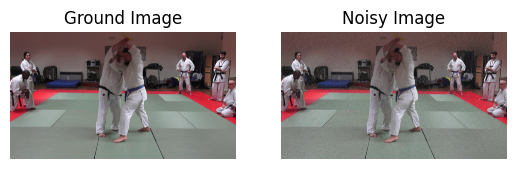

SSIM Score: 0.0801



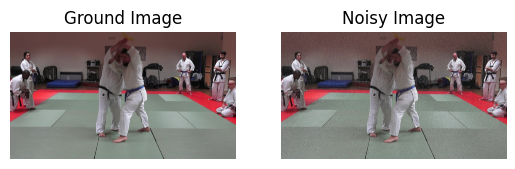

SSIM Score: 0.0799



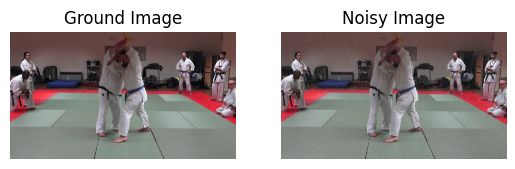

SSIM Score: 0.0801



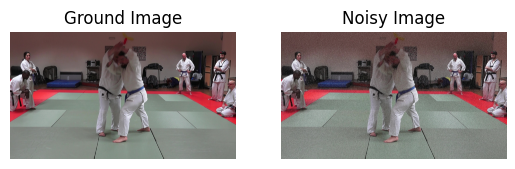

SSIM Score: 0.0803



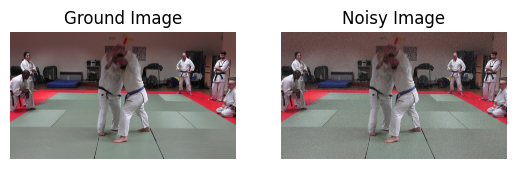

SSIM Score: 0.0802



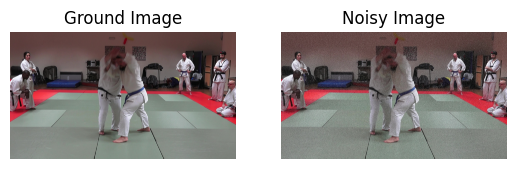

SSIM Score: 0.0797



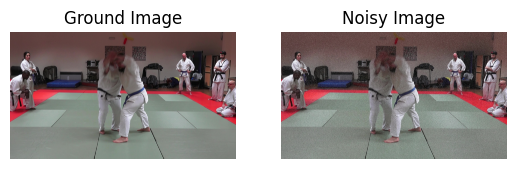

SSIM Score: 0.0798



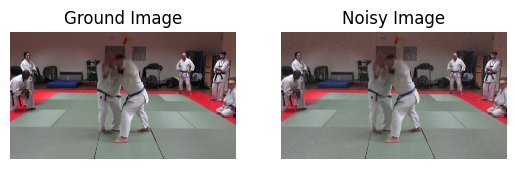

SSIM Score: 0.0796



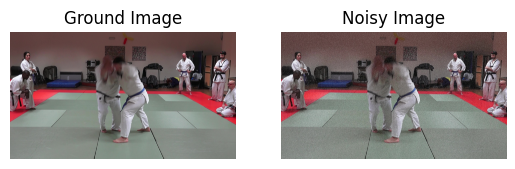

SSIM Score: 0.0796



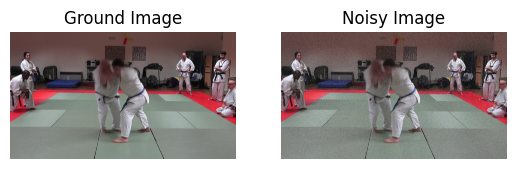

SSIM Score: 0.0798



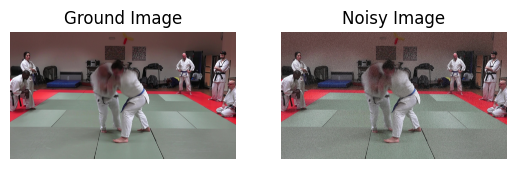

SSIM Score: 0.0794



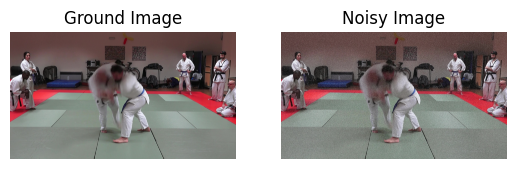

SSIM Score: 0.0792



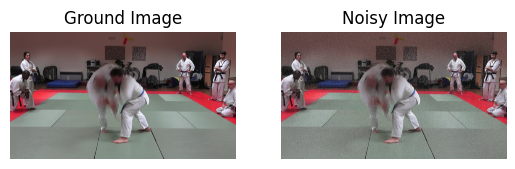

SSIM Score: 0.0799



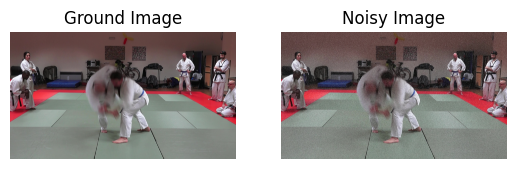

SSIM Score: 0.0797



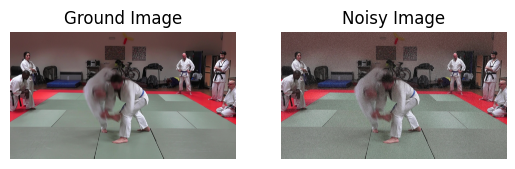

SSIM Score: 0.0801



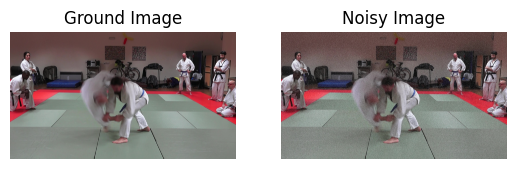

SSIM Score: 0.0797



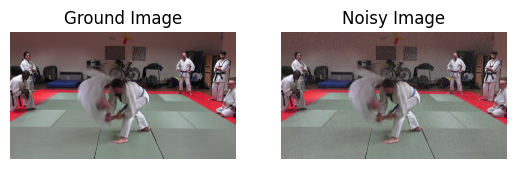

SSIM Score: 0.0794



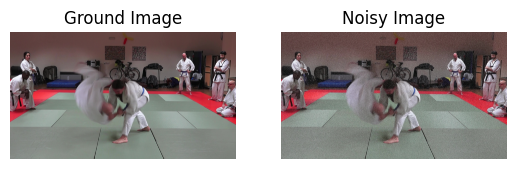

SSIM Score: 0.0790



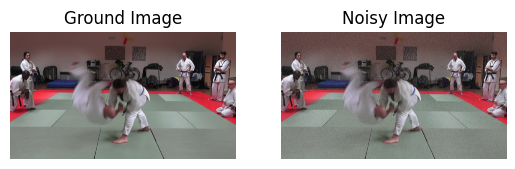

SSIM Score: 0.0792



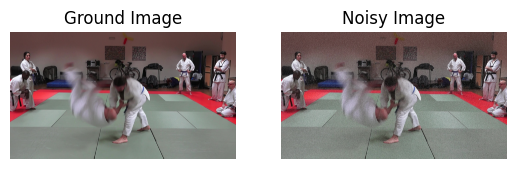

SSIM Score: 0.0792



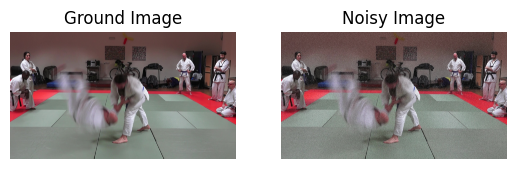

SSIM Score: 0.0791



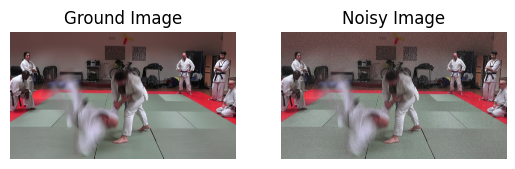

SSIM Score: 0.0789



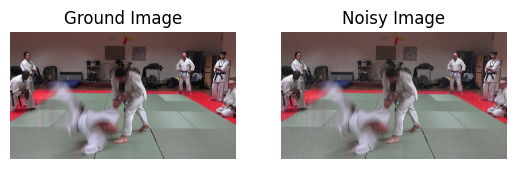

SSIM Score: 0.0794



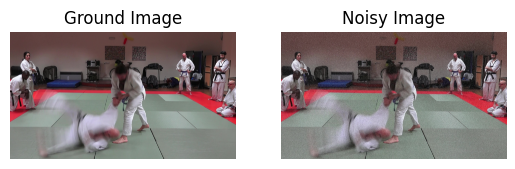

SSIM Score: 0.0800



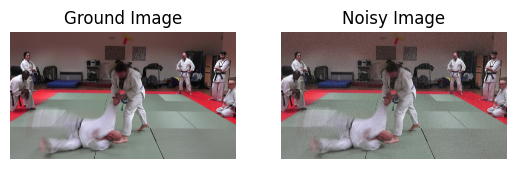

SSIM Score: 0.0804



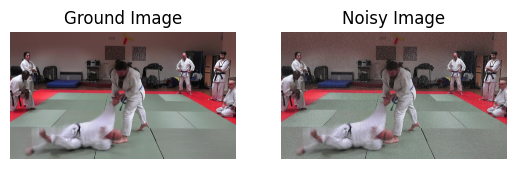

SSIM Score: 0.0810



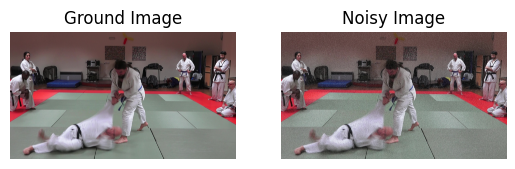

SSIM Score: 0.0818



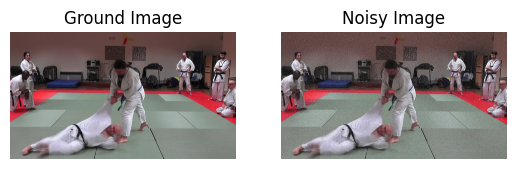

SSIM Score: 0.0821



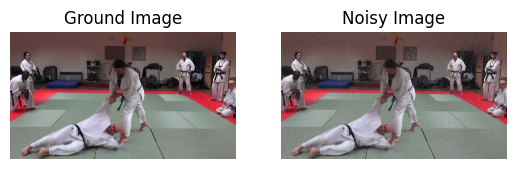

SSIM Score: 0.0833



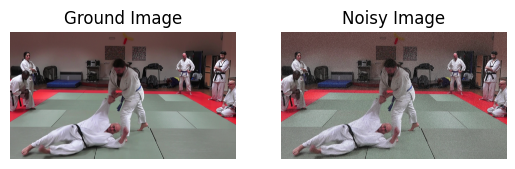

SSIM Score: 0.0834



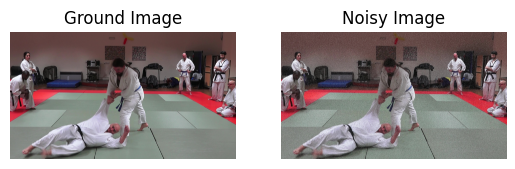

SSIM Score: 0.0837

Average SSIM Score: 0.0802


In [15]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from skimage.metrics import structural_similarity as ssim

# Create an empty list to store the SSIM scores
ssim_scores = []

for ground_image_path, noisy_image in zip(cleanFrames, noisyFrames):
    ground_image = Image.open(ground_image_path)
    noisy_image_obj = Image.fromarray(noisy_image)

    ground_image_gray = ground_image.convert('L')
    noisy_image_gray = noisy_image_obj.convert('L')

    plt.subplot(1, 2, 1)
    plt.imshow(ground_image)
    plt.title('Ground Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(noisy_image_obj)
    plt.title('Noisy Image')
    plt.axis('off')

    plt.show()

    # Convert to NumPy arrays
    ground_image_np = np.array(ground_image_gray)
    noisy_image_np = np.array(noisy_image_gray)

    # Calculate SSIM
    ssim_score = ssim(ground_image_np, noisy_image_np)
    print(f"SSIM Score: {ssim_score:.4f}\n")

    # Append the SSIM score to the list
    ssim_scores.append(ssim_score)

# Calculate the average SSIM score
average_ssim = np.mean(ssim_scores)
print(f"Average SSIM Score: {average_ssim:.4f}")

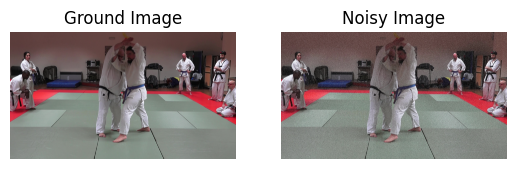

PSNR Score: 15.6304



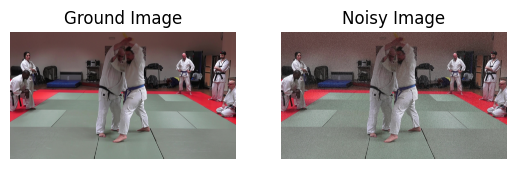

PSNR Score: 15.6254



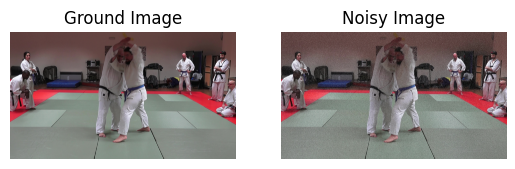

PSNR Score: 15.6284



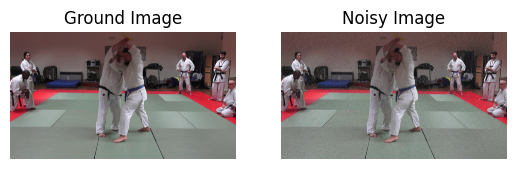

PSNR Score: 15.6213



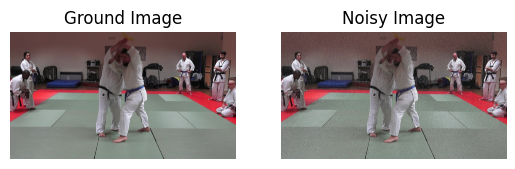

PSNR Score: 15.6205



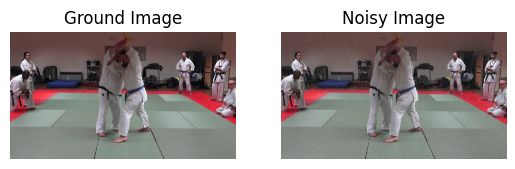

PSNR Score: 15.6249



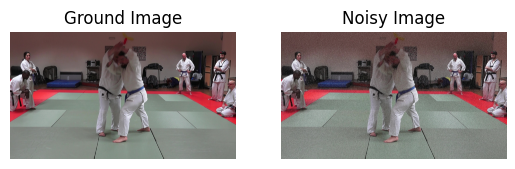

PSNR Score: 15.6287



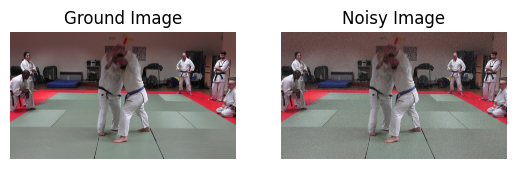

PSNR Score: 15.6292



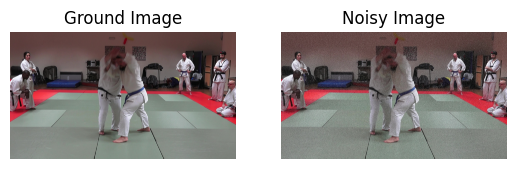

PSNR Score: 15.6210



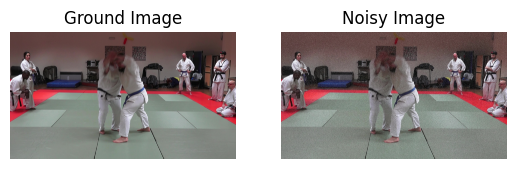

PSNR Score: 15.6257



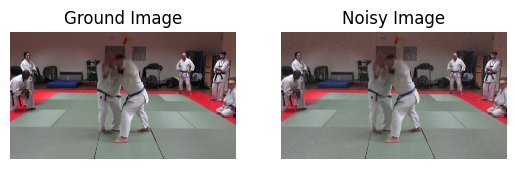

PSNR Score: 15.6223



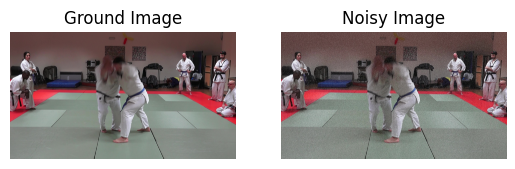

PSNR Score: 15.6209



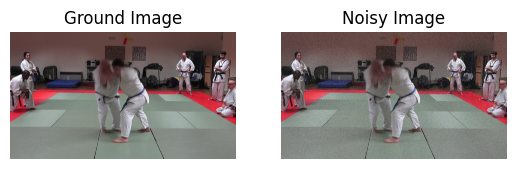

PSNR Score: 15.6195



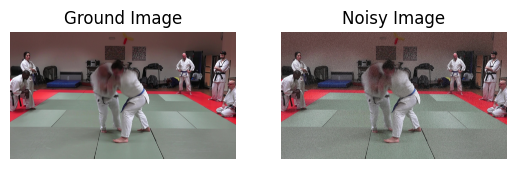

PSNR Score: 15.6111



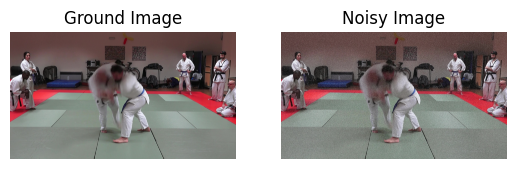

PSNR Score: 15.6044



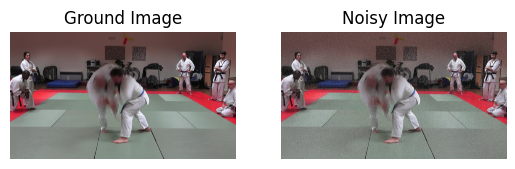

PSNR Score: 15.6141



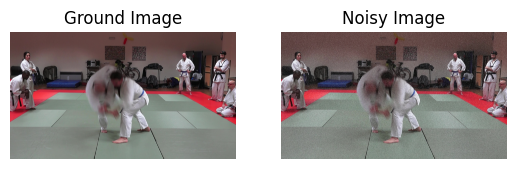

PSNR Score: 15.6019



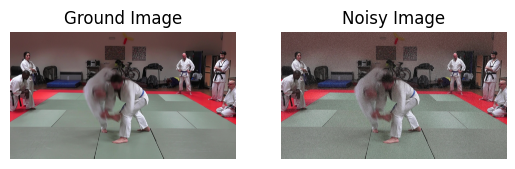

PSNR Score: 15.6042



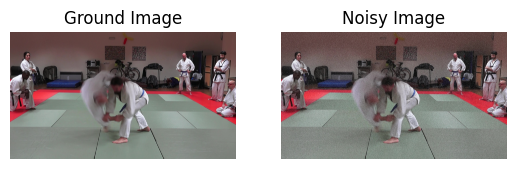

PSNR Score: 15.6068



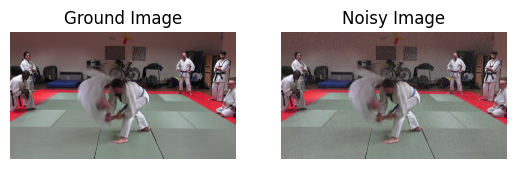

PSNR Score: 15.6073



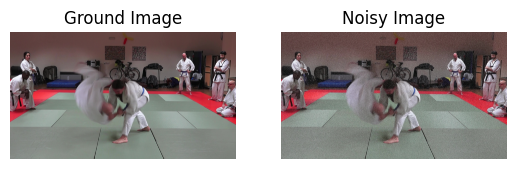

PSNR Score: 15.6126



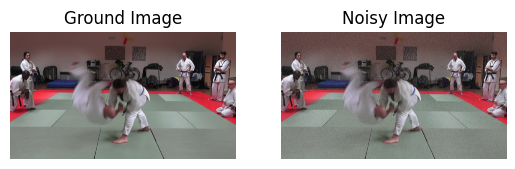

PSNR Score: 15.6021



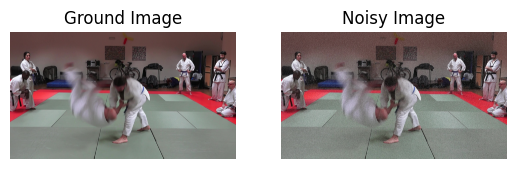

PSNR Score: 15.6063



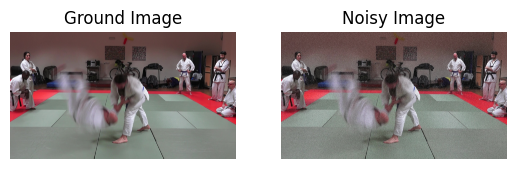

PSNR Score: 15.6153



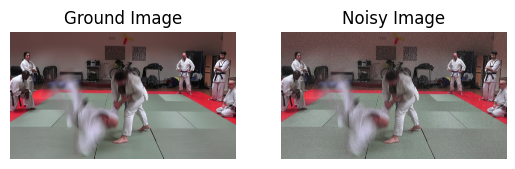

PSNR Score: 15.5933



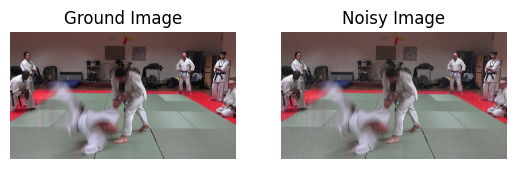

PSNR Score: 15.5796



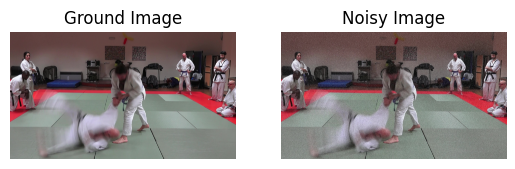

PSNR Score: 15.5680



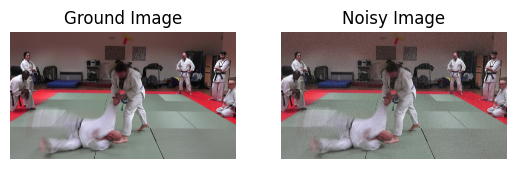

PSNR Score: 15.5527



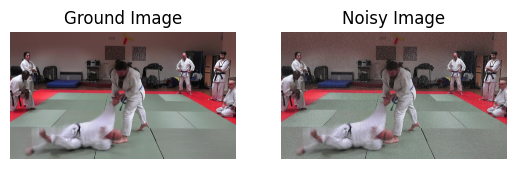

PSNR Score: 15.5446



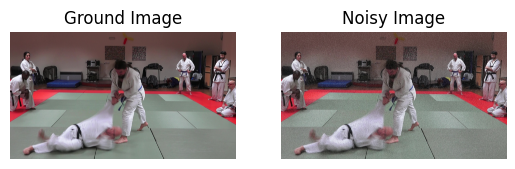

PSNR Score: 15.5401



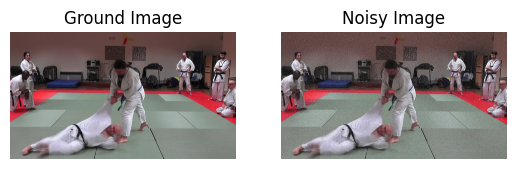

PSNR Score: 15.5349



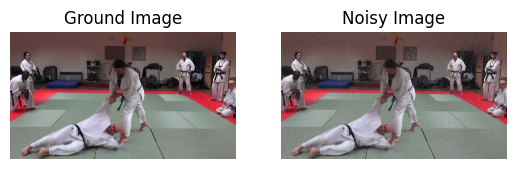

PSNR Score: 15.5252



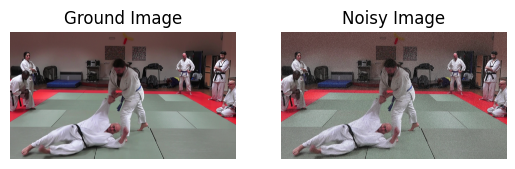

PSNR Score: 15.5293



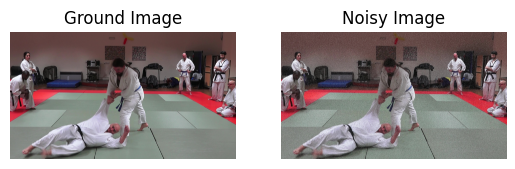

PSNR Score: 15.5340

Average PSNR Score: 15.5972


In [16]:
from skimage.metrics import peak_signal_noise_ratio as psnr

# Create an empty list to store the PSNR scores
psnr_scores = []

for ground_image_path, noisy_image in zip(cleanFrames, noisyFrames):
    ground_image = Image.open(ground_image_path)
    noisy_image_obj = Image.fromarray(noisy_image)

    plt.subplot(1, 2, 1)
    plt.imshow(ground_image)
    plt.title('Ground Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(noisy_image_obj)
    plt.title('Noisy Image')
    plt.axis('off')

    plt.show()

    # Convert to NumPy arrays
    ground_image_np = np.array(ground_image)
    noisy_image_np = np.array(noisy_image_obj)

    # Calculate PSNR
    psnr_score = psnr(ground_image_np, noisy_image_np)
    print(f"PSNR Score: {psnr_score:.4f}\n")

    # Append the PSNR score to the list
    psnr_scores.append(psnr_score)

# Calculate the average PSNR score
average_psnr = np.mean(psnr_scores)
print(f"Average PSNR Score: {average_psnr:.4f}")

# Goal 5: Apply a Gaussian Filter to the Frames and Measure How Long It Takes to Process Each Frame

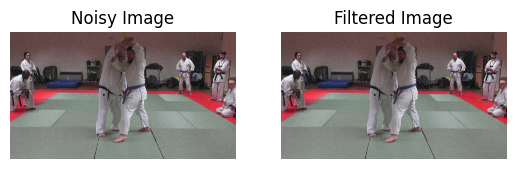

Execution Time: 0.4790 seconds



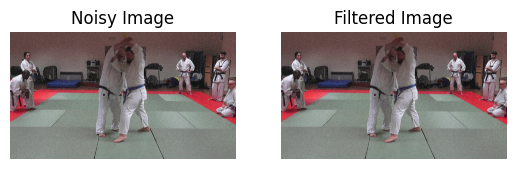

Execution Time: 0.5031 seconds



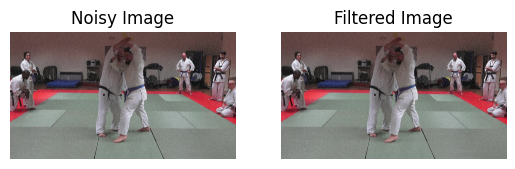

Execution Time: 0.4776 seconds



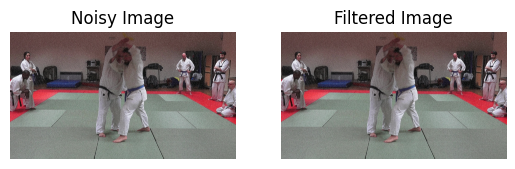

Execution Time: 0.4643 seconds



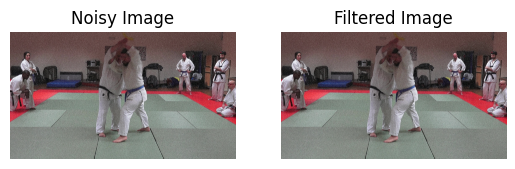

Execution Time: 0.4895 seconds



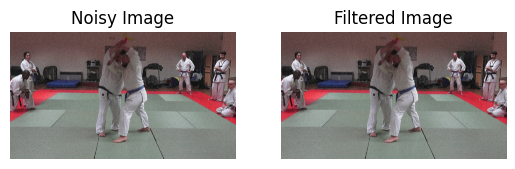

Execution Time: 0.5529 seconds



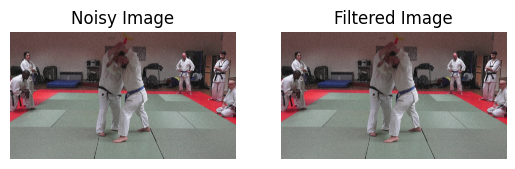

Execution Time: 0.5366 seconds



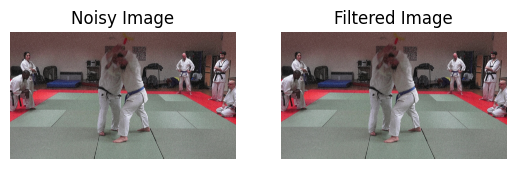

Execution Time: 0.4765 seconds



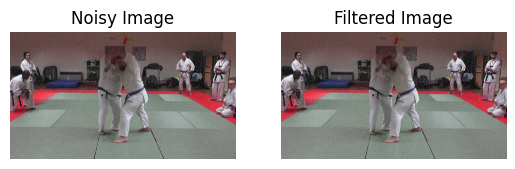

Execution Time: 0.4341 seconds



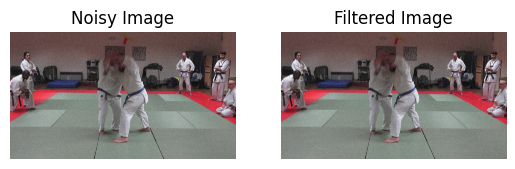

Execution Time: 0.4779 seconds



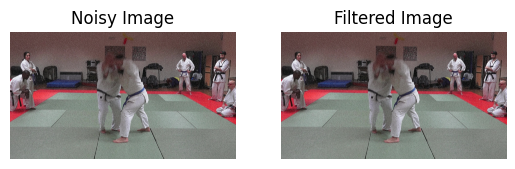

Execution Time: 0.5016 seconds



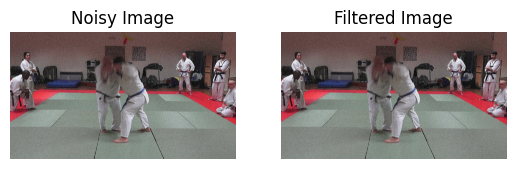

Execution Time: 0.4960 seconds



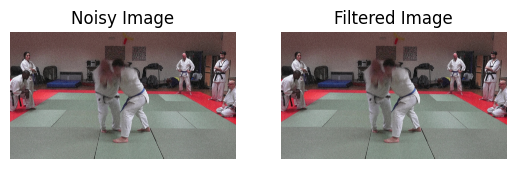

Execution Time: 0.5204 seconds



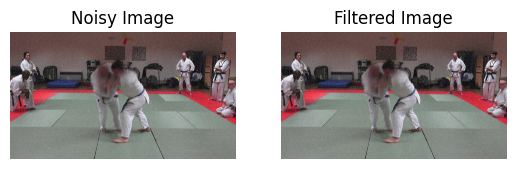

Execution Time: 0.4749 seconds



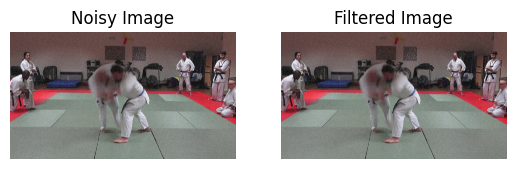

Execution Time: 0.6035 seconds



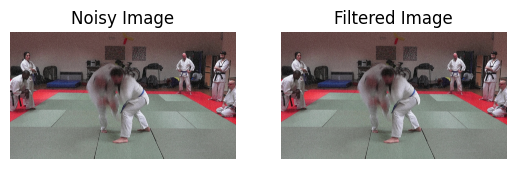

Execution Time: 0.4974 seconds



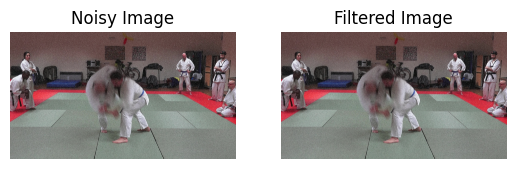

Execution Time: 0.4972 seconds



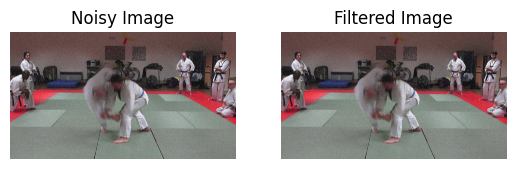

Execution Time: 0.4678 seconds



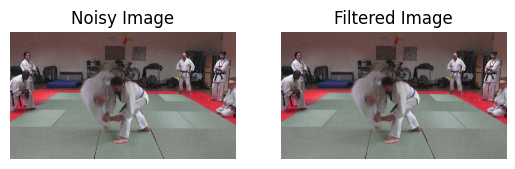

Execution Time: 0.5846 seconds



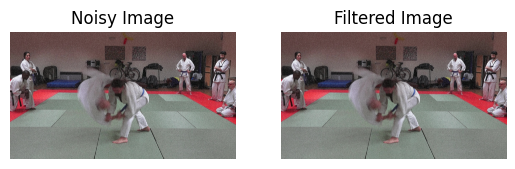

Execution Time: 0.4419 seconds



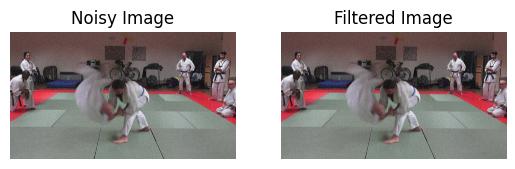

Execution Time: 0.5256 seconds



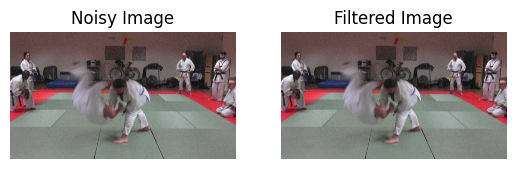

Execution Time: 0.4687 seconds



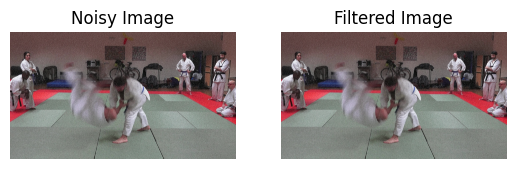

Execution Time: 0.5282 seconds



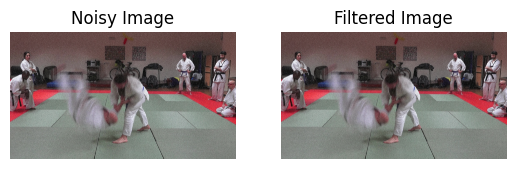

Execution Time: 0.5460 seconds



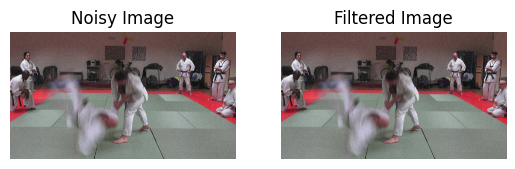

Execution Time: 0.6187 seconds



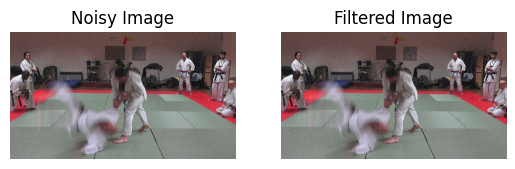

Execution Time: 0.4847 seconds



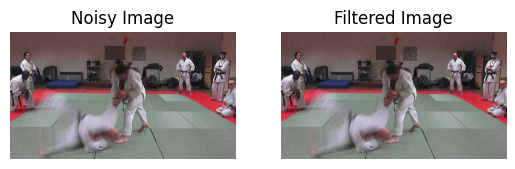

Execution Time: 0.5346 seconds



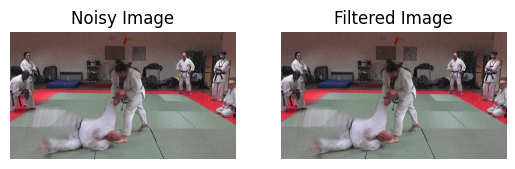

Execution Time: 0.5837 seconds



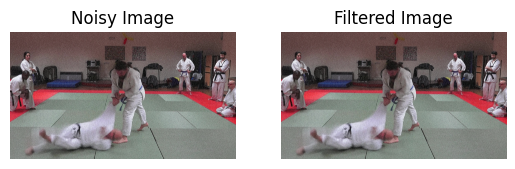

Execution Time: 0.6278 seconds



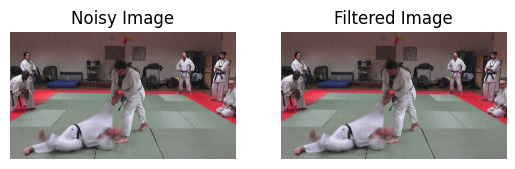

Execution Time: 0.5488 seconds



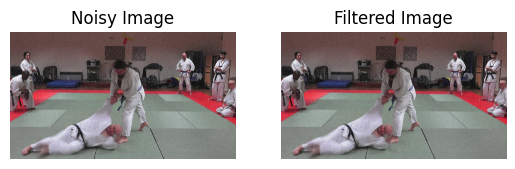

Execution Time: 0.4534 seconds



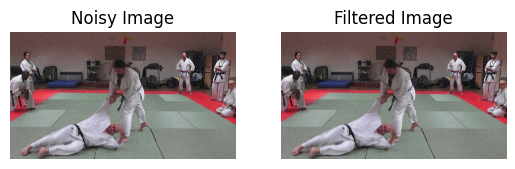

Execution Time: 0.4932 seconds



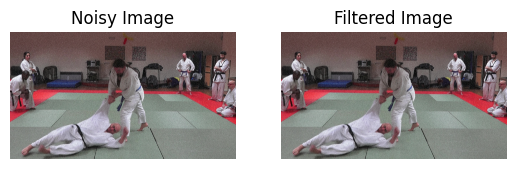

Execution Time: 0.5461 seconds



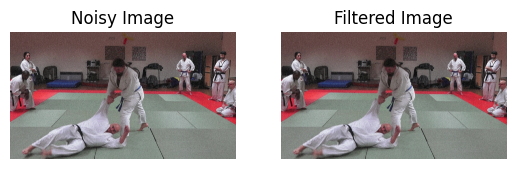

Execution Time: 0.4953 seconds

Average Execution Time: 0.5127 seconds



In [17]:
from skimage.filters import gaussian
import matplotlib.pyplot as plt
import time

# Define the parameters for the Gaussian filter --> These parameters can be edited to improve SSIM and PSNR scores.
sigma = 1.5 # Standard deviation of the Gaussian kernel
truncate = 2.0 # Truncation of the Gaussian kernel

# List to store the filtered images
filteredFrames = []

# List to store the execution times
executionTimes = []

# Apply Gaussian filter to each noisy image
for noisy_image in noisyFrames:
    noisy_image_arr = np.array(noisy_image)

    # Normalize the pixel values to the range of 0 to 1
    normalized_image_arr = noisy_image_arr.astype(np.float32) / 255.0

    # Apply the Gaussian filter
    start_time = time.time()
    filtered_image = gaussian(normalized_image_arr, sigma=sigma, truncate=truncate, multichannel=True)
    end_time = time.time()

    # Scale the pixel values back to the range of 0 to 255
    filtered_image_scaled = (filtered_image * 255.0).clip(0, 255).astype(np.uint8)

    # Convert the filtered image array back to PIL Image
    filtered_image_pil = Image.fromarray(filtered_image_scaled)

    # Add the filtered image to the list
    filteredFrames.append(filtered_image_pil)

    # Display the original noisy image and the filtered image
    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image)
    plt.title('Noisy Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered_image_pil)
    plt.title('Filtered Image')
    plt.axis('off')

    plt.show()

    # Calculate the execution time
    execution_time = end_time - start_time
    print(f"Execution Time: {execution_time:.4f} seconds\n")

    # Append the execution time to the list
    executionTimes.append(execution_time)

# Calculate the average execution time scores
average_execution_time = np.mean(executionTimes)
print(f"Average Execution Time: {average_execution_time:.4f} seconds\n")

# Goal 6: Play the Filtered Video

In [19]:
# Convert filteredFrames to NumPy arrays
filteredFrames_np = [np.asarray(image) for image in filteredFrames]

# Create a video clip from the frames
video = ImageSequenceClip(filteredFrames_np, fps=30)

# Define the output video path
filtered_video_path = 'C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/filtered_video.mp4'

# Write the filtered video to disk
video.write_videofile(filtered_video_path, codec='libx264', audio=False)

# Load the filtered video file
video_filtered = mp.VideoFileClip(filtered_video_path)

# Set the desired width and height for the resized video
width = 640
height = 480

# Resize the video while maintaining the aspect ratio
video_resized = video_filtered.resize(width=width)

# Display the resized video in the notebook
video_resized.ipython_display()

t:   6%|▌         | 2/35 [00:24<00:01, 18.36it/s, now=None]

Moviepy - Building video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/filtered_video.mp4.
Moviepy - Writing video C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/filtered_video.mp4



t:   6%|▌         | 2/35 [00:38<00:01, 18.36it/s, now=None]

Moviepy - Done !
Moviepy - video ready C:/Users/anish/Documents/VS Code -- Documents/Jupyter Notebooks/EML Lab -- DAVIS/filtered_video.mp4


t:   6%|▌         | 2/35 [00:41<00:01, 18.36it/s, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:   6%|▌         | 2/35 [00:47<00:01, 18.36it/s, now=None]

Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Goal 7: Compare the Filtered Video Quantitatively (SSIM, PSNR) to the Ground Truth Video

*  SSIM > 0.9: Excellent similarity. The reconstructed/filtered image closely resembles the original image.
*  0.7 < SSIM < 0.9: Good similarity. The reconstructed/filtered image has some minor differences but still maintains a high level of similarity to the original image.
*  0.5 < SSIM < 0.7: Moderate similarity. The reconstructed/filtered image has noticeable differences but still retains some level of similarity to the original image.
*  SSIM < 0.5: Poor similarity. The reconstructed/filtered image has significant differences and may not be visually similar to the original image. differences.

*   ############################################################

*   PSNR > 40 dB: Excellent quality. The reconstructed/filtered image closely resembles the original image.
*   30 dB < PSNR < 40 dB: Good quality. The reconstructed/filtered image has some minor imperfections but is still visually similar to the original image.
*    20 dB < PSNR < 30 dB: Moderate quality. The reconstructed/filtered image has noticeable distortions or noise but is still recognizable.
*    PSNR < 20 dB: Poor quality. The reconstructed/filtered image has significant distortions or noise and may differ significantly from the original image.


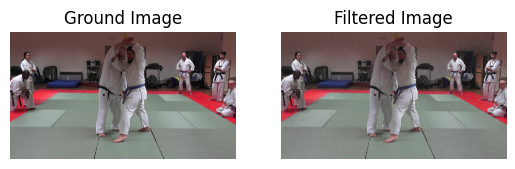

SSIM Score: 0.6323



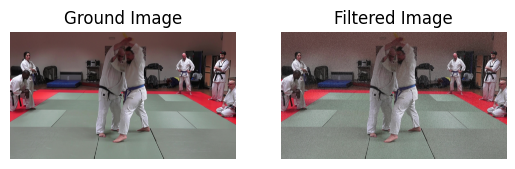

SSIM Score: 0.6320



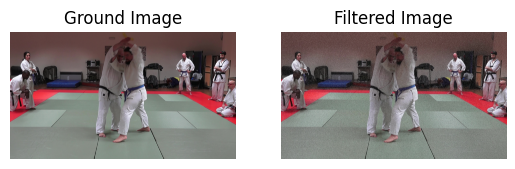

SSIM Score: 0.6319



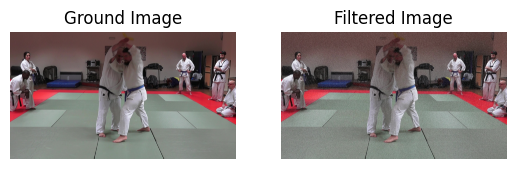

SSIM Score: 0.6321



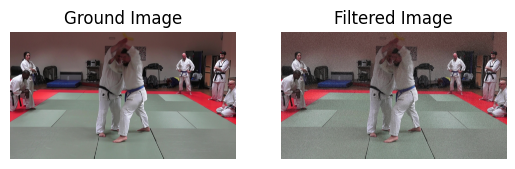

SSIM Score: 0.6321



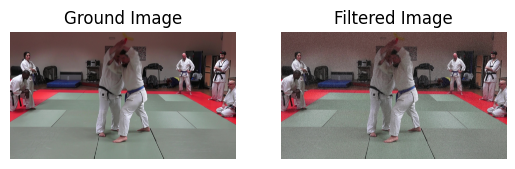

SSIM Score: 0.6320



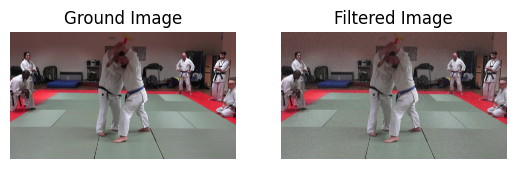

SSIM Score: 0.6322



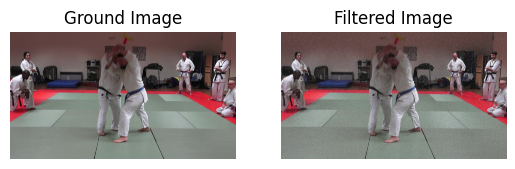

SSIM Score: 0.6326



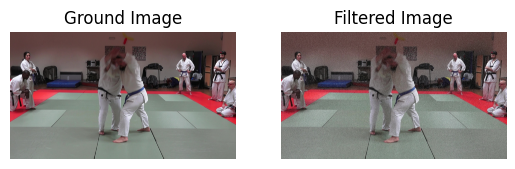

SSIM Score: 0.6315



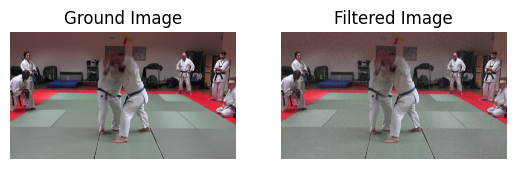

SSIM Score: 0.6323



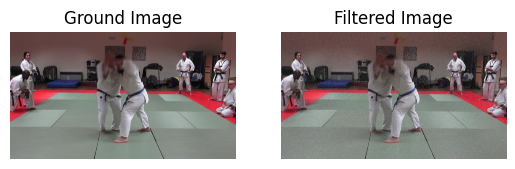

SSIM Score: 0.6316



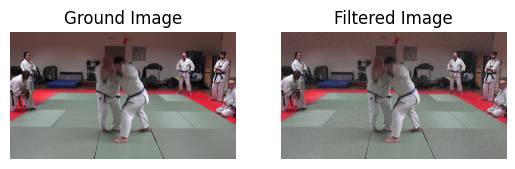

SSIM Score: 0.6318



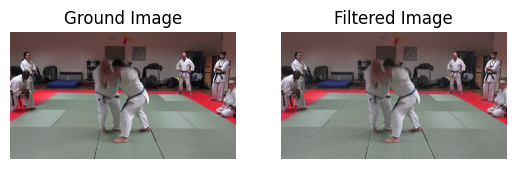

SSIM Score: 0.6312



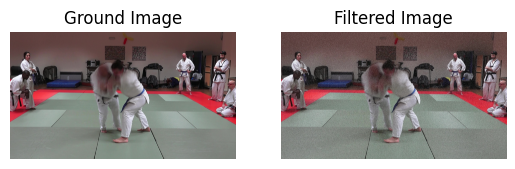

SSIM Score: 0.6320



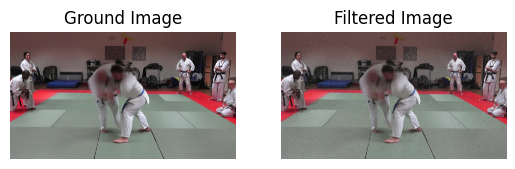

SSIM Score: 0.6309



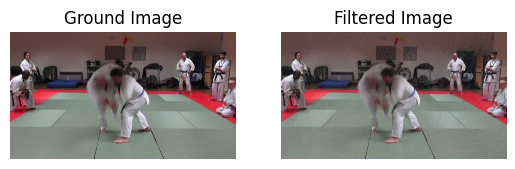

SSIM Score: 0.6315



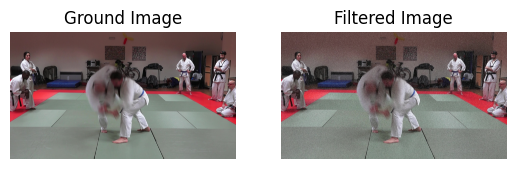

SSIM Score: 0.6310



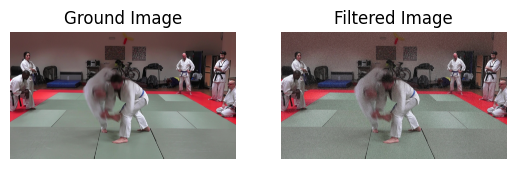

SSIM Score: 0.6316



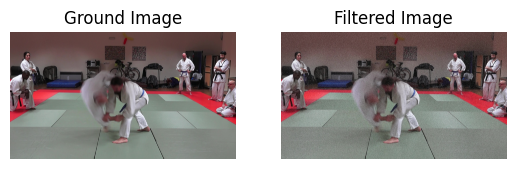

SSIM Score: 0.6312



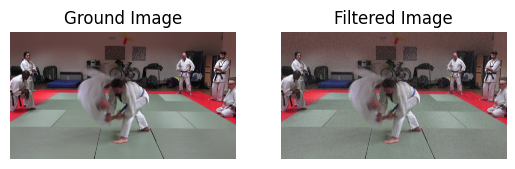

SSIM Score: 0.6317



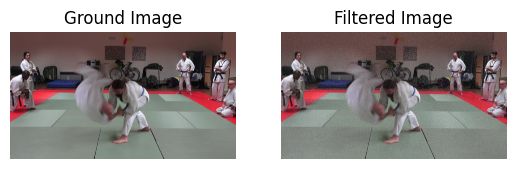

SSIM Score: 0.6309



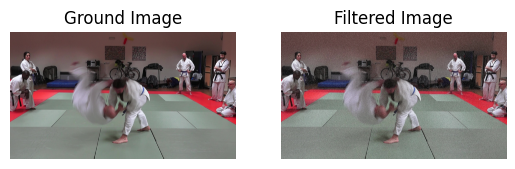

SSIM Score: 0.6310



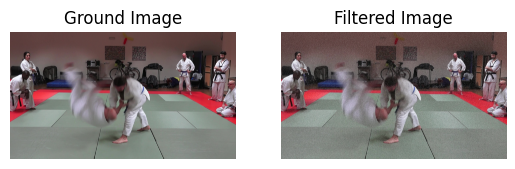

SSIM Score: 0.6311



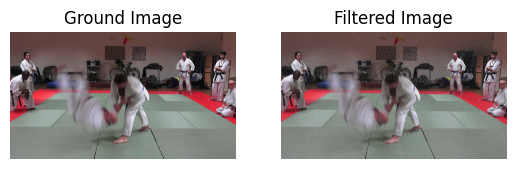

SSIM Score: 0.6318



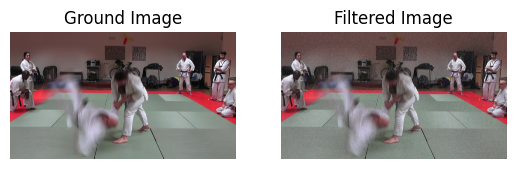

SSIM Score: 0.6303



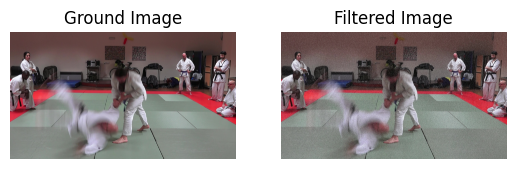

SSIM Score: 0.6307



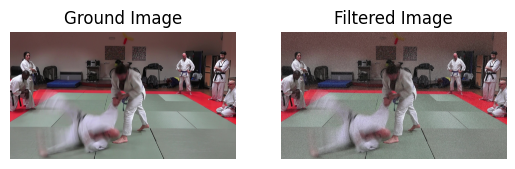

SSIM Score: 0.6298



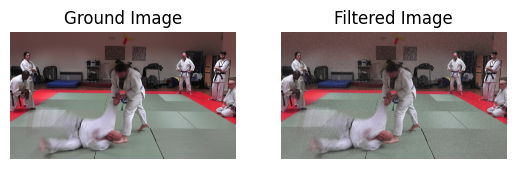

SSIM Score: 0.6305



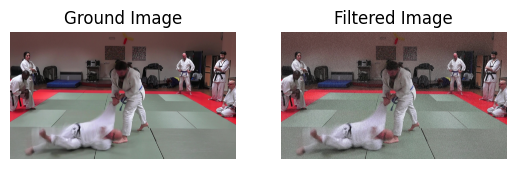

SSIM Score: 0.6305



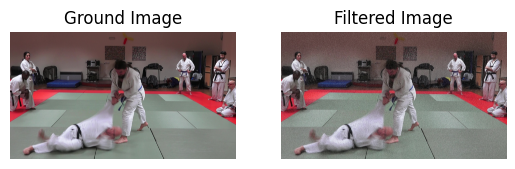

SSIM Score: 0.6312



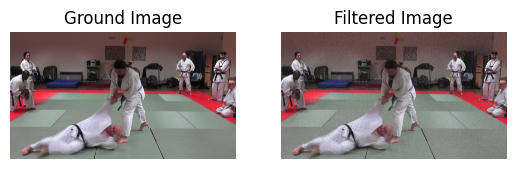

SSIM Score: 0.6324



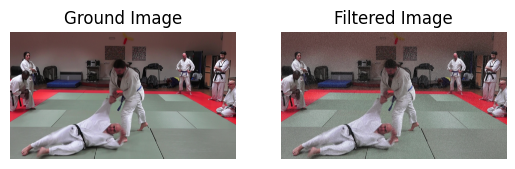

SSIM Score: 0.6327



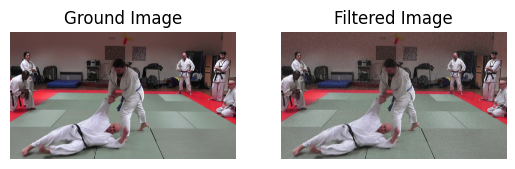

SSIM Score: 0.6338



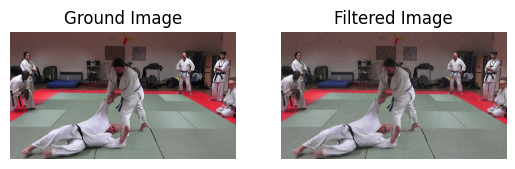

SSIM Score: 0.6336

Average SSIM Score: 0.6316


In [20]:
# Create an empty list to store the SSIM scores
ssim_scores = []

for ground_image_path, filtered_image in zip(cleanFrames, filteredFrames):
    ground_image = Image.open(ground_image_path)
    filtered_image_obj = filtered_image

    ground_image_gray = ground_image.convert('L')
    filtered_image_gray = filtered_image_obj.convert('L')

    plt.subplot(1, 2, 1)
    plt.imshow(ground_image)
    plt.title('Ground Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered_image_obj)
    plt.title('Filtered Image')
    plt.axis('off')

    plt.show()

    # Convert to NumPy arrays
    ground_image_np = np.array(ground_image_gray)
    filtered_image_np = np.array(filtered_image_gray)

    # Calculate SSIM
    ssim_score = ssim(ground_image_np, filtered_image_np)
    print(f"SSIM Score: {ssim_score:.4f}\n")

    # Append the SSIM score to the list
    ssim_scores.append(ssim_score)

# Calculate the average SSIM score
average_ssim = np.mean(ssim_scores)
print(f"Average SSIM Score: {average_ssim:.4f}")

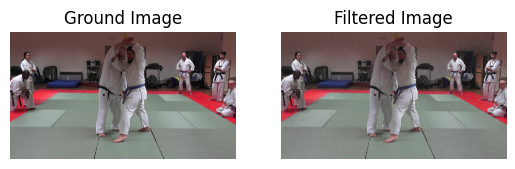

PSNR Score: 28.5703



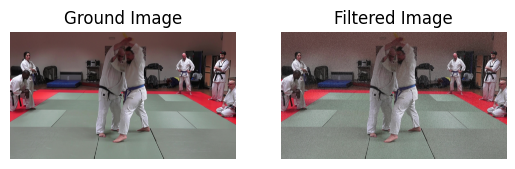

PSNR Score: 28.5511



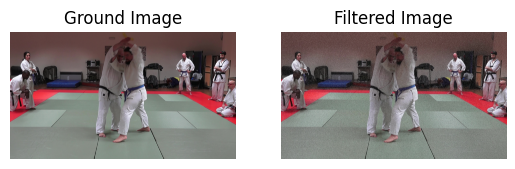

PSNR Score: 28.5742



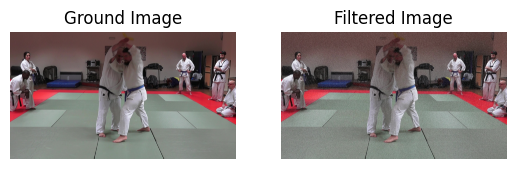

PSNR Score: 28.5460



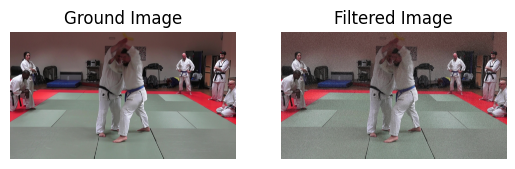

PSNR Score: 28.5356



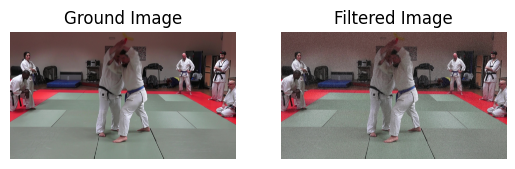

PSNR Score: 28.5416



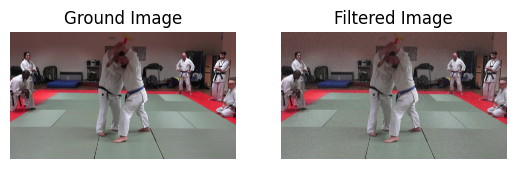

PSNR Score: 28.5573



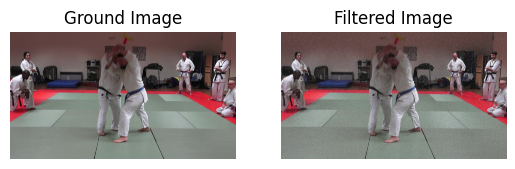

PSNR Score: 28.5702



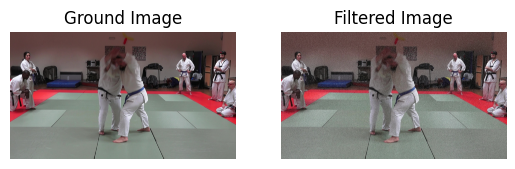

PSNR Score: 28.5456



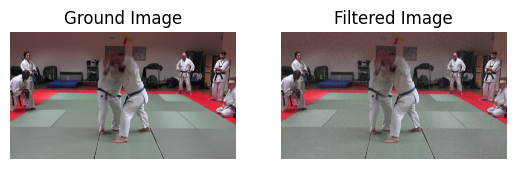

PSNR Score: 28.5597



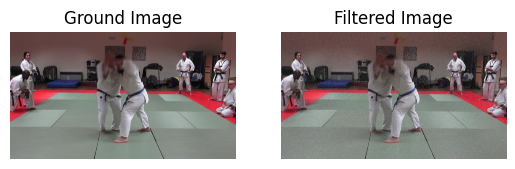

PSNR Score: 28.5475



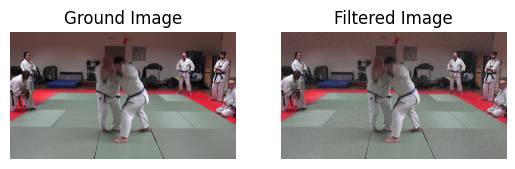

PSNR Score: 28.5445



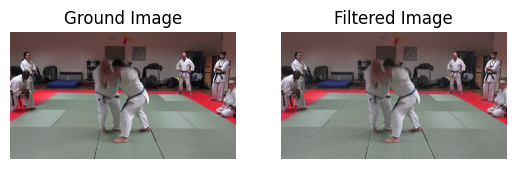

PSNR Score: 28.5395



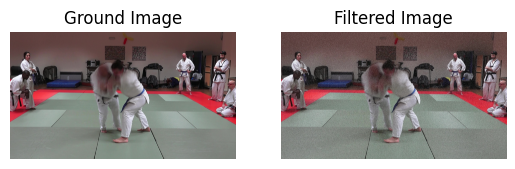

PSNR Score: 28.5255



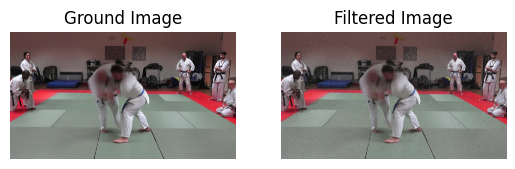

PSNR Score: 28.5128



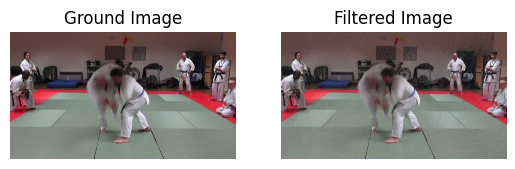

PSNR Score: 28.5322



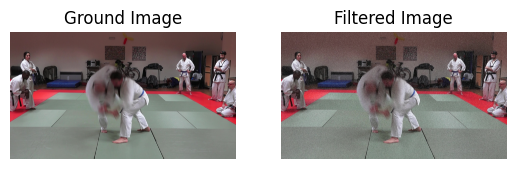

PSNR Score: 28.5050



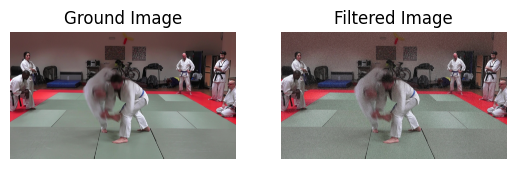

PSNR Score: 28.5164



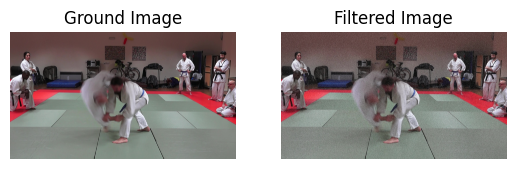

PSNR Score: 28.5216



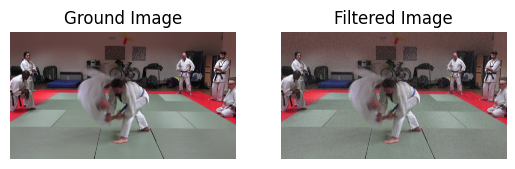

PSNR Score: 28.5225



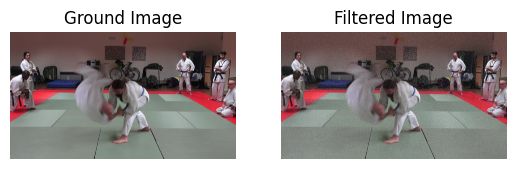

PSNR Score: 28.5382



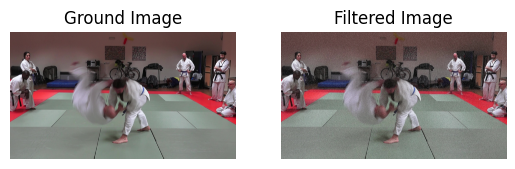

PSNR Score: 28.5033



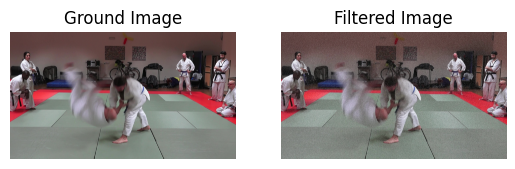

PSNR Score: 28.5242



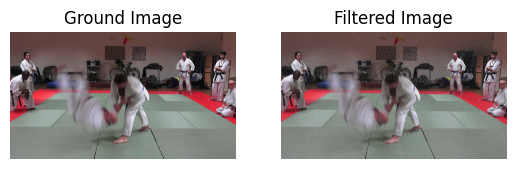

PSNR Score: 28.5460



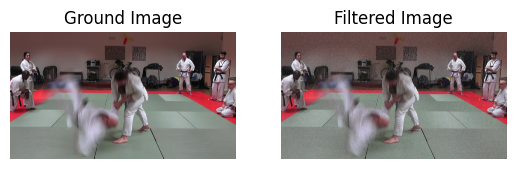

PSNR Score: 28.4862



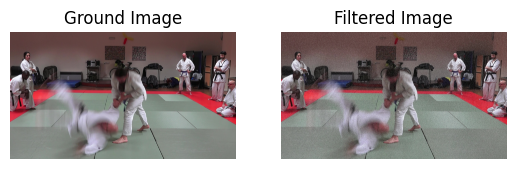

PSNR Score: 28.4436



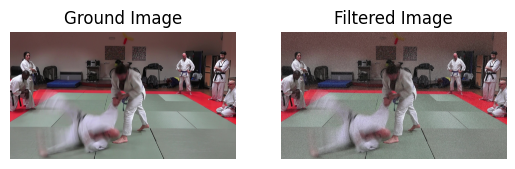

PSNR Score: 28.4168



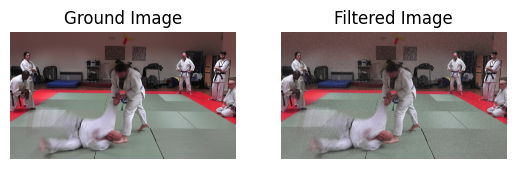

PSNR Score: 28.3683



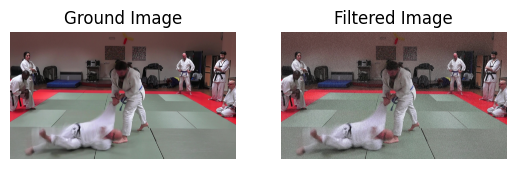

PSNR Score: 28.3535



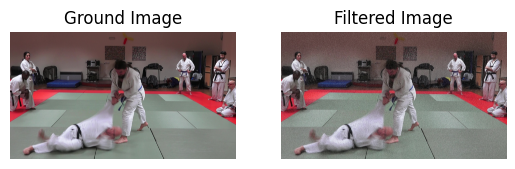

PSNR Score: 28.3331



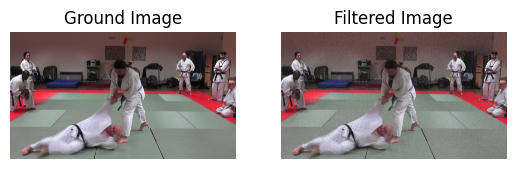

PSNR Score: 28.3273



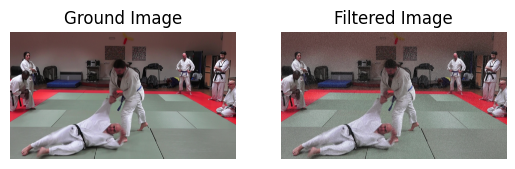

PSNR Score: 28.2840



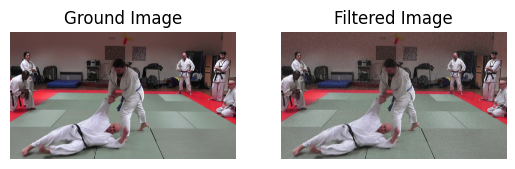

PSNR Score: 28.2987



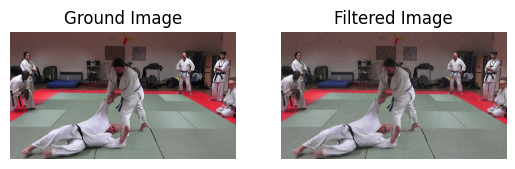

PSNR Score: 28.3061

Average PSNR Score: 28.4867


In [21]:
# Create an empty list to store the PSNR scores
psnr_scores = []

for ground_image, filtered_image in zip(cleanFrames, filteredFrames):
    ground_image = Image.open(ground_image)
    filtered_image = filtered_image

    plt.subplot(1, 2, 1)
    plt.imshow(ground_image)
    plt.title('Ground Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered_image)
    plt.title('Filtered Image')
    plt.axis('off')

    plt.show()

    # Convert to NumPy arrays
    ground_image = np.array(ground_image)
    filtered_image = np.array(filtered_image)

    # Calculate PSNR
    psnr_score = psnr(ground_image, filtered_image)
    print(f"PSNR Score: {psnr_score:.4f}\n")

    # Append the PSNR score to the list
    psnr_scores.append(psnr_score)

# Calculate the average PSNR score
average_psnr = np.mean(psnr_scores)
print(f"Average PSNR Score: {average_psnr:.4f}")

# Extra: Cropped Image Pairs of the Following Size -->

*   480p --> (854, 480)
*   720p --> (1280, 720)
*   1080p --> (1920, 1080)
*   4K (If Possible) --> (3840, 2160)

We can use the cropped samples to infer what kind of process to expect with videos of said quality. Make sure we measure the time it takes to clean these crops with the gaussian filter.

**To Implement Just Move the Code Snippets to the Desired Location.**

In [22]:
from PIL import Image

# Define the target resolution
target_resolution = (854, 480)

# Resize cleanFrames
resized_cleanFrames = []
for image_path in cleanFrames:
    image = Image.open(image_path)
    resized_image = image.resize(target_resolution, Image.ANTIALIAS)
    resized_cleanFrames.append(resized_image)

# Resize noisyFrames
resized_noisyFrames = []
for image in noisyFrames:
    image_pil = Image.fromarray(image)
    resized_image = image_pil.resize(target_resolution, Image.ANTIALIAS)
    resized_noisyFrames.append(resized_image)

# Resize filteredFrames
resized_filteredFrames = []
for image in filteredFrames_np:
    image_pil = Image.fromarray(image)
    resized_image = image_pil.resize(target_resolution, Image.ANTIALIAS)
    resized_filteredFrames.append(resized_image)

In [23]:
# Verify Results
print(resized_cleanFrames[0].size)
print(resized_noisyFrames[0].size)
print(resized_filteredFrames[0].size)

(854, 480)
(854, 480)
(854, 480)
